# https://www.kaggle.com/datasets/shriyashjagtap/fraudulent-e-commerce-transactions/code

In [69]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import plotly.express as px

In [2]:
fraud_path = r'F:\DataSpell\Pandas_training\Fraud\data_set\Fraudulent_E-Commerce_Transaction_Data.csv'

In [3]:
fraud = pd.read_csv(fraud_path, parse_dates=['Transaction Date']).dropna(how='all')

In [4]:
def is_fraudulent(row):
    if row == 1: return True
    else: return False

fraud['Is Fraudulent'] = fraud['Is Fraudulent'].apply(is_fraudulent)

In [5]:
fraud['Payment Method'] = fraud['Payment Method'].str.lower().astype('category')
fraud['Product Category'] = fraud['Product Category'].str.lower().astype('category')
fraud['Quantity'] = pd.to_numeric(fraud['Quantity'], downcast='integer')
fraud['Customer Age'] = pd.to_numeric(fraud['Customer Age'], downcast='integer')
fraud['Device Used'] = fraud['Device Used'].str.lower().astype('category')
fraud['Is Fraudulent'] = fraud['Is Fraudulent'].astype(bool)
fraud['Account Age Days'] = pd.to_numeric(fraud['Account Age Days'], downcast='integer')
fraud['Transaction Hour'] = pd.to_numeric(fraud['Transaction Hour'], downcast='integer')

In [6]:
fraud.head()

,Transaction ID,Customer ID,Transaction Amount,Transaction Date,Payment Method,Product Category,Quantity,Customer Age,Customer Location,Device Used,IP Address,Shipping Address,Billing Address,Is Fraudulent,Account Age Days,Transaction Hour
0,15d2e414-8735-46fc-9e02-80b472b2580f,d1b87f62-51b2-493b-ad6a-77e0fe13e785,58.09,2024-02-20 05:58:41,bank transfer,electronics,1,17,Amandaborough,tablet,212.195.49.198,Unit 8934 Box 0058\nDPO AA 05437,Unit 8934 Box 0058\nDPO AA 05437,False,30,5
1,0bfee1a0-6d5e-40da-a446-d04e73b1b177,37de64d5-e901-4a56-9ea0-af0c24c069cf,389.96,2024-02-25 08:09:45,debit card,electronics,2,40,East Timothy,desktop,208.106.249.121,"634 May Keys\nPort Cherylview, NV 75063","634 May Keys\nPort Cherylview, NV 75063",False,72,8
2,e588eef4-b754-468e-9d90-d0e0abfc1af0,1bac88d6-4b22-409a-a06b-425119c57225,134.19,2024-03-18 03:42:55,paypal,home & garden,2,22,Davismouth,tablet,76.63.88.212,"16282 Dana Falls Suite 790\nRothhaven, IL 15564","16282 Dana Falls Suite 790\nRothhaven, IL 15564",False,63,3
3,4de46e52-60c3-49d9-be39-636681009789,2357c76e-9253-4ceb-b44e-ef4b71cb7d4d,226.17,2024-03-16 20:41:31,bank transfer,clothing,5,31,Lynnberg,desktop,207.208.171.73,"828 Strong Loaf Apt. 646\nNew Joshua, UT 84798","828 Strong Loaf Apt. 646\nNew Joshua, UT 84798",False,124,20
4,074a76de-fe2d-443e-a00c-f044cdb68e21,45071bc5-9588-43ea-8093-023caec8ea1c,121.53,2024-01-15 05:08:17,bank transfer,clothing,2,51,South Nicole,tablet,190.172.14.169,"29799 Jason Hills Apt. 439\nWest Richardtown, ...","29799 Jason Hills Apt. 439\nWest Richardtown, ...",False,158,5


In [7]:
%%time 
# fraud.info() # 179.8+ MB # 102.5+ MB
fraud.nunique() # 2.29 s

CPU times: total: 1.59 s
Wall time: 2.13 s


Transaction ID        1472952
Customer ID           1472952
Transaction Amount     108998
Transaction Date      1346684
Payment Method              4
Product Category            5
Quantity                    5
Customer Age               97
Customer Location       99135
Device Used                 3
IP Address            1472651
Shipping Address      1472948
Billing Address       1472949
Is Fraudulent               2
Account Age Days          365
Transaction Hour           24
dtype: int64

In [8]:
fraud.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1472952 entries, 0 to 1472951
Data columns (total 16 columns):
 #   Column              Non-Null Count    Dtype         
---  ------              --------------    -----         
 0   Transaction ID      1472952 non-null  object        
 1   Customer ID         1472952 non-null  object        
 2   Transaction Amount  1472952 non-null  float64       
 3   Transaction Date    1472952 non-null  datetime64[ns]
 4   Payment Method      1472952 non-null  category      
 5   Product Category    1472952 non-null  category      
 6   Quantity            1472952 non-null  int8          
 7   Customer Age        1472952 non-null  int8          
 8   Customer Location   1472952 non-null  object        
 9   Device Used         1472952 non-null  category      
 10  IP Address          1472952 non-null  object        
 11  Shipping Address    1472952 non-null  object        
 12  Billing Address     1472952 non-null  object        
 13  Is Fraudulen

# 1. How many unique customers are there in the dataset?

In [9]:
fraud.head()

,Transaction ID,Customer ID,Transaction Amount,Transaction Date,Payment Method,Product Category,Quantity,Customer Age,Customer Location,Device Used,IP Address,Shipping Address,Billing Address,Is Fraudulent,Account Age Days,Transaction Hour
0,15d2e414-8735-46fc-9e02-80b472b2580f,d1b87f62-51b2-493b-ad6a-77e0fe13e785,58.09,2024-02-20 05:58:41,bank transfer,electronics,1,17,Amandaborough,tablet,212.195.49.198,Unit 8934 Box 0058\nDPO AA 05437,Unit 8934 Box 0058\nDPO AA 05437,False,30,5
1,0bfee1a0-6d5e-40da-a446-d04e73b1b177,37de64d5-e901-4a56-9ea0-af0c24c069cf,389.96,2024-02-25 08:09:45,debit card,electronics,2,40,East Timothy,desktop,208.106.249.121,"634 May Keys\nPort Cherylview, NV 75063","634 May Keys\nPort Cherylview, NV 75063",False,72,8
2,e588eef4-b754-468e-9d90-d0e0abfc1af0,1bac88d6-4b22-409a-a06b-425119c57225,134.19,2024-03-18 03:42:55,paypal,home & garden,2,22,Davismouth,tablet,76.63.88.212,"16282 Dana Falls Suite 790\nRothhaven, IL 15564","16282 Dana Falls Suite 790\nRothhaven, IL 15564",False,63,3
3,4de46e52-60c3-49d9-be39-636681009789,2357c76e-9253-4ceb-b44e-ef4b71cb7d4d,226.17,2024-03-16 20:41:31,bank transfer,clothing,5,31,Lynnberg,desktop,207.208.171.73,"828 Strong Loaf Apt. 646\nNew Joshua, UT 84798","828 Strong Loaf Apt. 646\nNew Joshua, UT 84798",False,124,20
4,074a76de-fe2d-443e-a00c-f044cdb68e21,45071bc5-9588-43ea-8093-023caec8ea1c,121.53,2024-01-15 05:08:17,bank transfer,clothing,2,51,South Nicole,tablet,190.172.14.169,"29799 Jason Hills Apt. 439\nWest Richardtown, ...","29799 Jason Hills Apt. 439\nWest Richardtown, ...",False,158,5


In [10]:
fraud['Customer ID'].nunique()

1472952

# 2. What is the total number of fraudulent transactions?

In [11]:
# fraud['Transaction Amount'].sum()
fraud[fraud['Is Fraudulent'] == 1].shape[0]

73838

# 3. Calculate the total transaction amount for each payment method.

In [13]:
fraud

,Transaction ID,Customer ID,Transaction Amount,Transaction Date,Payment Method,Product Category,Quantity,Customer Age,Customer Location,Device Used,IP Address,Shipping Address,Billing Address,Is Fraudulent,Account Age Days,Transaction Hour
0,15d2e414-8735-46fc-9e02-80b472b2580f,d1b87f62-51b2-493b-ad6a-77e0fe13e785,58.09,2024-02-20 05:58:41,bank transfer,electronics,1,17,Amandaborough,tablet,212.195.49.198,Unit 8934 Box 0058\nDPO AA 05437,Unit 8934 Box 0058\nDPO AA 05437,False,30,5
1,0bfee1a0-6d5e-40da-a446-d04e73b1b177,37de64d5-e901-4a56-9ea0-af0c24c069cf,389.96,2024-02-25 08:09:45,debit card,electronics,2,40,East Timothy,desktop,208.106.249.121,"634 May Keys\nPort Cherylview, NV 75063","634 May Keys\nPort Cherylview, NV 75063",False,72,8
2,e588eef4-b754-468e-9d90-d0e0abfc1af0,1bac88d6-4b22-409a-a06b-425119c57225,134.19,2024-03-18 03:42:55,paypal,home & garden,2,22,Davismouth,tablet,76.63.88.212,"16282 Dana Falls Suite 790\nRothhaven, IL 15564","16282 Dana Falls Suite 790\nRothhaven, IL 15564",False,63,3
3,4de46e52-60c3-49d9-be39-636681009789,2357c76e-9253-4ceb-b44e-ef4b71cb7d4d,226.17,2024-03-16 20:41:31,bank transfer,clothing,5,31,Lynnberg,desktop,207.208.171.73,"828 Strong Loaf Apt. 646\nNew Joshua, UT 84798","828 Strong Loaf Apt. 646\nNew Joshua, UT 84798",False,124,20
4,074a76de-fe2d-443e-a00c-f044cdb68e21,45071bc5-9588-43ea-8093-023caec8ea1c,121.53,2024-01-15 05:08:17,bank transfer,clothing,2,51,South Nicole,tablet,190.172.14.169,"29799 Jason Hills Apt. 439\nWest Richardtown, ...","29799 Jason Hills Apt. 439\nWest Richardtown, ...",False,158,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1472947,c8604004-2f4c-42ce-a1c4-cd2bebca79bb,f8a534ad-0458-465e-a85b-3ad2cdf391bc,208.48,2024-01-12 23:39:55,paypal,health & beauty,2,29,North Laurafort,desktop,27.245.104.92,USNV Griffin\nFPO AA 52700,USNV Griffin\nFPO AA 52700,False,149,23
1472948,fff0df19-fd4a-42a5-bc42-64bb7b02edb0,f2ef2239-d9b9-40d0-9993-4b8f305d5a7b,231.57,2024-03-27 04:31:45,credit card,clothing,2,32,Burnsville,tablet,203.54.50.163,"478 John Square Apt. 235\nMillerhaven, GA 68797","478 John Square Apt. 235\nMillerhaven, GA 68797",False,132,4
1472949,9e79012f-e00b-47d1-8700-0c302db20d3e,fa5b9a25-9606-478a-8abe-ef20bbb3980f,101.80,2024-01-31 23:51:42,bank transfer,electronics,4,36,Garciafort,mobile,51.241.30.149,"351 Frazier Radial Apt. 989\nPort Charles, OH ...","182 House Island Suite 198\nEast Scott, FM 84301",False,98,23
1472950,917066b1-4dfb-4472-b3f0-292663c45d21,04524272-e14f-460b-bc70-5316bd28463d,61.80,2024-01-12 16:21:32,bank transfer,electronics,5,34,Lake Josephberg,desktop,210.67.203.4,"27307 Gonzalez Shore Suite 661\nPort Lynn, WV ...","27307 Gonzalez Shore Suite 661\nPort Lynn, WV ...",False,191,16


In [21]:
fraud.groupby('Payment Method', observed=True)['Transaction Amount'].sum().sort_values(ascending=False)

Payment Method
credit card      83661081.21
debit card       83549743.48
bank transfer    83478725.23
paypal           83329284.71
Name: Transaction Amount, dtype: float64

# 4. Identify the top 5 product categories by transaction amount.

In [24]:
fraud.groupby('Product Category')['Transaction Amount'].sum().sort_values(ascending=False)

C:\Users\Zygim\AppData\Local\Temp\ipykernel_33856\1808018089.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  fraud.groupby('Product Category')['Transaction Amount'].sum().sort_values(ascending=False)


Product Category
health & beauty    67016381.79
electronics        67013075.65
home & garden      66730176.85
toys & games       66686429.80
clothing           66572770.54
Name: Transaction Amount, dtype: float64

# 5. What is the average customer age?

In [26]:
fraud['Customer Age'].mean()

34.5120811811926

# 6. How many unique customer locations are present?

In [28]:
fraud

,Transaction ID,Customer ID,Transaction Amount,Transaction Date,Payment Method,Product Category,Quantity,Customer Age,Customer Location,Device Used,IP Address,Shipping Address,Billing Address,Is Fraudulent,Account Age Days,Transaction Hour
0,15d2e414-8735-46fc-9e02-80b472b2580f,d1b87f62-51b2-493b-ad6a-77e0fe13e785,58.09,2024-02-20 05:58:41,bank transfer,electronics,1,17,Amandaborough,tablet,212.195.49.198,Unit 8934 Box 0058\nDPO AA 05437,Unit 8934 Box 0058\nDPO AA 05437,False,30,5
1,0bfee1a0-6d5e-40da-a446-d04e73b1b177,37de64d5-e901-4a56-9ea0-af0c24c069cf,389.96,2024-02-25 08:09:45,debit card,electronics,2,40,East Timothy,desktop,208.106.249.121,"634 May Keys\nPort Cherylview, NV 75063","634 May Keys\nPort Cherylview, NV 75063",False,72,8
2,e588eef4-b754-468e-9d90-d0e0abfc1af0,1bac88d6-4b22-409a-a06b-425119c57225,134.19,2024-03-18 03:42:55,paypal,home & garden,2,22,Davismouth,tablet,76.63.88.212,"16282 Dana Falls Suite 790\nRothhaven, IL 15564","16282 Dana Falls Suite 790\nRothhaven, IL 15564",False,63,3
3,4de46e52-60c3-49d9-be39-636681009789,2357c76e-9253-4ceb-b44e-ef4b71cb7d4d,226.17,2024-03-16 20:41:31,bank transfer,clothing,5,31,Lynnberg,desktop,207.208.171.73,"828 Strong Loaf Apt. 646\nNew Joshua, UT 84798","828 Strong Loaf Apt. 646\nNew Joshua, UT 84798",False,124,20
4,074a76de-fe2d-443e-a00c-f044cdb68e21,45071bc5-9588-43ea-8093-023caec8ea1c,121.53,2024-01-15 05:08:17,bank transfer,clothing,2,51,South Nicole,tablet,190.172.14.169,"29799 Jason Hills Apt. 439\nWest Richardtown, ...","29799 Jason Hills Apt. 439\nWest Richardtown, ...",False,158,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1472947,c8604004-2f4c-42ce-a1c4-cd2bebca79bb,f8a534ad-0458-465e-a85b-3ad2cdf391bc,208.48,2024-01-12 23:39:55,paypal,health & beauty,2,29,North Laurafort,desktop,27.245.104.92,USNV Griffin\nFPO AA 52700,USNV Griffin\nFPO AA 52700,False,149,23
1472948,fff0df19-fd4a-42a5-bc42-64bb7b02edb0,f2ef2239-d9b9-40d0-9993-4b8f305d5a7b,231.57,2024-03-27 04:31:45,credit card,clothing,2,32,Burnsville,tablet,203.54.50.163,"478 John Square Apt. 235\nMillerhaven, GA 68797","478 John Square Apt. 235\nMillerhaven, GA 68797",False,132,4
1472949,9e79012f-e00b-47d1-8700-0c302db20d3e,fa5b9a25-9606-478a-8abe-ef20bbb3980f,101.80,2024-01-31 23:51:42,bank transfer,electronics,4,36,Garciafort,mobile,51.241.30.149,"351 Frazier Radial Apt. 989\nPort Charles, OH ...","182 House Island Suite 198\nEast Scott, FM 84301",False,98,23
1472950,917066b1-4dfb-4472-b3f0-292663c45d21,04524272-e14f-460b-bc70-5316bd28463d,61.80,2024-01-12 16:21:32,bank transfer,electronics,5,34,Lake Josephberg,desktop,210.67.203.4,"27307 Gonzalez Shore Suite 661\nPort Lynn, WV ...","27307 Gonzalez Shore Suite 661\nPort Lynn, WV ...",False,191,16


In [31]:
fraud['Customer Location'].nunique()

99135

# 7. Find the quantity of products sold per product category.

In [33]:
fraud.groupby('Product Category')['Quantity'].sum()

C:\Users\Zygim\AppData\Local\Temp\ipykernel_33856\2849066161.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  fraud.groupby('Product Category')['Quantity'].sum()


Product Category
clothing           882711
electronics        887152
health & beauty    885988
home & garden      880596
toys & games       882748
Name: Quantity, dtype: int64

# 8. Determine the most common device used for transactions.

In [36]:
fraud.groupby('Device Used')['Transaction Amount'].count()

C:\Users\Zygim\AppData\Local\Temp\ipykernel_33856\2917499040.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  fraud.groupby('Device Used')['Transaction Amount'].count()


Device Used
desktop    490271
mobile     491743
tablet     490938
Name: Transaction Amount, dtype: int64

In [41]:
fraud['Device Used'].value_counts().idxmax()

'mobile'

# 9. What are the top 10 most common IP addresses?

In [44]:
fraud['IP Address'].value_counts(ascending=False).head(10)

IP Address
170.118.178.249    2
40.173.110.187     2
221.95.171.82      2
157.14.79.59       2
100.9.174.89       2
65.182.248.252     2
114.218.202.86     2
163.187.187.215    2
65.45.167.149      2
29.8.5.93          2
Name: count, dtype: int64

# 10. Calculate the average transaction amount per day of the week.

In [54]:
# fraud['Transaction Date'].dt.dayofweek
day_name = fraud['Transaction Date'].dt.day_name()
fraud.groupby(day_name)['Transaction Amount'].mean()

Transaction Date
Friday       226.308732
Monday       226.994752
Saturday     226.372693
Sunday       227.056536
Thursday     226.196070
Tuesday      227.250533
Wednesday    227.135949
Name: Transaction Amount, dtype: float64

# Data Cleaning

# 1. Check for missing values in the dataset.

In [56]:
fraud.isna().sum()

Transaction ID        0
Customer ID           0
Transaction Amount    0
Transaction Date      0
Payment Method        0
Product Category      0
Quantity              0
Customer Age          0
Customer Location     0
Device Used           0
IP Address            0
Shipping Address      0
Billing Address       0
Is Fraudulent         0
Account Age Days      0
Transaction Hour      0
dtype: int64

# 2. Identify any duplicate transactions, based on Transaction ID.

In [61]:
fraud['Transaction Hour'].duplicated(keep=False).sum()

1472952

# 3. Standardize the format of Transaction Date to a datetime format (YYYY-MM-DD HH:MM:SS).

In [62]:
fraud_date = fraud['Transaction Date'].dt.strftime('%Y-%m-%d %H:%M:%S')
fraud_date

0          2024-02-20 05:58:41
1          2024-02-25 08:09:45
2          2024-03-18 03:42:55
3          2024-03-16 20:41:31
4          2024-01-15 05:08:17
                  ...         
1472947    2024-01-12 23:39:55
1472948    2024-03-27 04:31:45
1472949    2024-01-31 23:51:42
1472950    2024-01-12 16:21:32
1472951    2024-02-19 18:57:20
Name: Transaction Date, Length: 1472952, dtype: object

# 4. Are there any anomalies in the Customer Age column (e.g., ages that are too high or too low)?

In [64]:
fraud['Customer Age'].describe()

count    1.472952e+06
mean     3.451208e+01
std      1.000313e+01
min     -1.600000e+01
25%      2.800000e+01
50%      3.500000e+01
75%      4.100000e+01
max      8.600000e+01
Name: Customer Age, dtype: float64

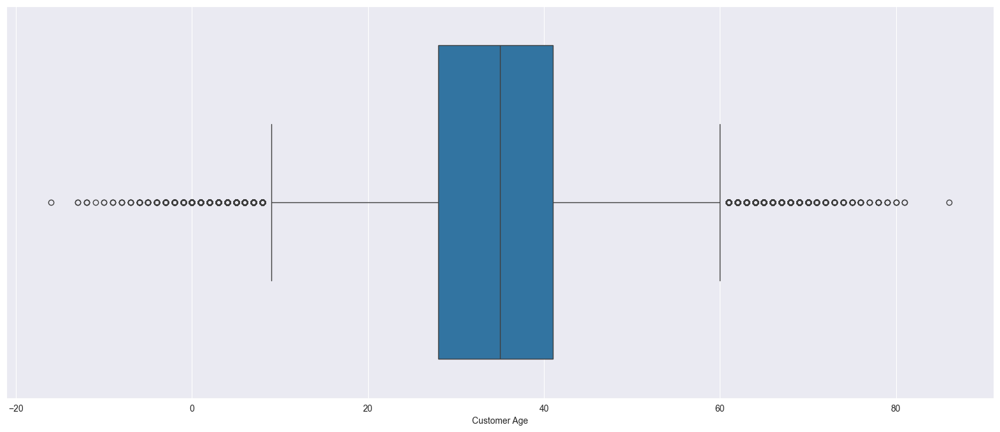

In [70]:
plt.figure(figsize=(20, 8))
sns.boxplot(x=fraud['Customer Age'])
plt.show()

In [73]:
fig = px.box(fraud, y='Customer Age')
fig.update_layout(autosize=False, width=1000, height=1000)
fig.show()

# 5. Validate the format of IP addresses; identify any records with invalid IP address formats.

In [74]:
import ipaddress

def is_valid_ip(ip):
    try:
        ipaddress.ip_address(ip)
        return True
    except ValueError:
        return False

In [77]:
fraud_valid_ip = fraud['IP Address'].apply(is_valid_ip).astype(bool)
invalid_ips = fraud[~fraud_valid_ip]
invalid_ips

,Transaction ID,Customer ID,Transaction Amount,Transaction Date,Payment Method,Product Category,Quantity,Customer Age,Customer Location,Device Used,IP Address,Shipping Address,Billing Address,Is Fraudulent,Account Age Days,Transaction Hour
